# Capstone Project - The Battle of the Neighborhoods
### Applied Data Science Capstone by IBM on Coursera

## Table of contents
* [Introduction: Business Problem](#introduction)
* [Data](#data)
* [Methodology](#methodology)  
    * [Data Cleaning and Wrapping](#DCW)
    * [Data Visualization](#DV)
    * [Data Mining](#DM)
    * [Modelling](#Model)

## Introduction <a name="introduction"></a>

### Business Problem

Barcelona, Spain, is one of the most popular tourist destinations. According to Inside Airbnb [1], on 19th April 2019, there were 17,899 properties listed in Airbnb website. Accompany with tourist attraction data from Foursquare, I manage to obtain an insight, how to maximize properties profit by setting the optimized price. This will benefit investors who want to invest in the properties in Barcelona or the residents who already have properties and want to make a profit from them.Note that, this work only pay attention to short stay (i.e. about or less than a week). 

[1] Inside Airbnb (2019), http://insideairbnb.com/get-the-data.html, accessed on 27th May 2019

### Data <a name="data"></a>

#### [Airbnb data](#airbnb) 
from http://insideairbnb.com/get-the-data.html (Barcelona, Catalonia, Spain). The files that are used for this project are  
* listings.csv.gz
* neighbourhoods.csv (Neighbourhood list for geo filter)
* neighbourhoods.geojson (GeoJSON file of neighbourhoods of the city).  

All files were obtained on 27th May 2019. All files were compiled on 10 April 2019.  

#### [Attractions](#trip)
The attractions are obtained by web scraping (BeautifulSoup) from Tripadvisor https://www.tripadvisor.co.uk/Attractions-g187497-Activities-Barcelona_Catalonia.html, accessed on 2nd Jun 2019  

#### [Nearby attractions](#4sq)
The attractions details (such as name, location, type) are obtained by using **Foursquare API**.  

### Let's have a quick look in Airbnb data first <a name="airbnb"></a>

In [1]:
import pandas as pd
import numpy as np 
from bs4 import BeautifulSoup
import requests
import matplotlib.pyplot as plt

In [2]:
listing = pd.read_csv('listings 2.csv', low_memory=False)

In [3]:
print (listing.shape)
listing.head(5)

(17899, 106)


,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,18666,https://www.airbnb.com/rooms/18666,20190410191814,2019-04-10,Flat with Sunny Terrace,"Apartment located near the ""Plaza de las Glori...",Nice apartment situated on the penthouse floor...,"Apartment located near the ""Plaza de las Glori...",none,Apartment in Barcelona near to the Plaza de la...,...,f,f,flexible,f,f,28,28,0,0,0.02
1,18674,https://www.airbnb.com/rooms/18674,20190410191814,2019-04-10,Huge flat for 8 people close to Sagrada Familia,110m2 apartment to rent in Barcelona. Located ...,Apartment with 110 m2 located in the 6th floor...,110m2 apartment to rent in Barcelona. Located ...,none,Apartment in Barcelona located in the heart of...,...,t,f,strict_14_with_grace_period,f,f,28,28,0,0,0.10
2,21605,https://www.airbnb.com/rooms/21605,20190410191814,2019-04-10,Nice and sunny duble room,"The flat is in Poblenou district, and the room...","L'apartament està al barri de Poblenou, i l'ha...","The flat is in Poblenou district, and the room...",none,Poblenou as one of the few areas that has grow...,...,f,f,moderate,f,f,2,0,2,0,3.01
3,23197,https://www.airbnb.com/rooms/23197,20190410191814,2019-04-10,FORUM DELUXE 5 MINS WALK CCIB CENTER & SEA!,"Beautiful apartment, large terrace, 5 min walk...",Elegant spacious apartment suitable for 6. Amp...,"Beautiful apartment, large terrace, 5 min walk...",none,Strategically located in the area of Parc del ...,...,t,f,strict_14_with_grace_period,f,t,2,2,0,0,0.36
4,25786,https://www.airbnb.com/rooms/25786,20190410191814,2019-04-10,NICE ROOM AVAILABLE IN THE HEART OF GRACIA,JUST GO THROUGH THE MANY REVIEWS I GOT THROUGH...,Room available for rent.- PEDRO PEREZ. Share...,JUST GO THROUGH THE MANY REVIEWS I GOT THROUGH...,none,Solo decir que a menudo ni salgo del barrio. M...,...,t,f,strict_14_with_grace_period,t,t,1,0,1,0,2.12


Listing has 106 columns, some of them is not need to be considered (e.g. url). Therefore, I only select some specific columns. Then, I will remove listing valiable from my notebook to clear memory.

In [4]:
list_used = listing.loc[:,['id', 'name','host_id', 'host_name', 'property_type','room_type','latitude', 'longitude',  \
                          'accommodates', 'bathrooms', 'bedrooms', 'beds', \
                          'square_feet','price', 'cleaning_fee', 'security_deposit', 'guests_included', 'extra_people', \
                          'minimum_nights_avg_ntm', 'availability_365', 'number_of_reviews', 'review_scores_value', \
                          'review_scores_location','reviews_per_month','neighbourhood_group_cleansed','neighbourhood_cleansed']]
print (list_used.shape)
list_used.head(3)

(17899, 26)


,id,name,host_id,host_name,property_type,room_type,latitude,longitude,accommodates,bathrooms,...,guests_included,extra_people,minimum_nights_avg_ntm,availability_365,number_of_reviews,review_scores_value,review_scores_location,reviews_per_month,neighbourhood_group_cleansed,neighbourhood_cleansed
0,18666,Flat with Sunny Terrace,71615,Mireia And Maria,Apartment,Entire home/apt,41.40889,2.18555,6,1.0,...,2,$25.00,3.0,91,1,8.0,10.0,0.02,Sant Martí,el Camp de l'Arpa del Clot
1,18674,Huge flat for 8 people close to Sagrada Familia,71615,Mireia And Maria,Apartment,Entire home/apt,41.40420,2.17306,8,2.0,...,2,$30.00,3.7,219,7,8.0,9.0,0.10,Eixample,la Sagrada Família
2,21605,Nice and sunny duble room,82522,Meritxell,Apartment,Private room,41.40560,2.19821,2,1.0,...,1,$10.00,2.8,254,107,9.0,9.0,3.01,Sant Martí,el Poblenou


Apart from unimportant columns (e.g. url, summary, space), I dorp some features such as bed_type, amenities. Because, this kind of information is hard to interpret. Weekly price , and Monthly price are also excluded because the objective of this work is for short-stay.

In [5]:
del listing  # release memory

__Now__, the dataframe has only 26 columns (from 106). However, it has 17899 rows. This still too large. Let's apply a short rent criterion as minimum stay is less than or equal 3.

In [6]:
list_used.drop(list_used[list_used['minimum_nights_avg_ntm'] > 3].index, axis = 0, inplace = True)

In [7]:
print (list_used.shape)
list_used.head(3)

(12219, 26)


,id,name,host_id,host_name,property_type,room_type,latitude,longitude,accommodates,bathrooms,...,guests_included,extra_people,minimum_nights_avg_ntm,availability_365,number_of_reviews,review_scores_value,review_scores_location,reviews_per_month,neighbourhood_group_cleansed,neighbourhood_cleansed
0,18666,Flat with Sunny Terrace,71615,Mireia And Maria,Apartment,Entire home/apt,41.40889,2.18555,6,1.0,...,2,$25.00,3.0,91,1,8.0,10.0,0.02,Sant Martí,el Camp de l'Arpa del Clot
2,21605,Nice and sunny duble room,82522,Meritxell,Apartment,Private room,41.40560,2.19821,2,1.0,...,1,$10.00,2.8,254,107,9.0,9.0,3.01,Sant Martí,el Poblenou
4,25786,NICE ROOM AVAILABLE IN THE HEART OF GRACIA,108310,Pedro,Apartment,Private room,41.40145,2.15645,2,1.0,...,1,$31.00,1.0,100,224,9.0,10.0,2.12,Gràcia,la Vila de Gràcia


### Get list of attractions from Tripadvisor using web scraping <a name="trip"></a>

In [8]:
## The result of this script is same as manually copy the name of the attractions. # Internet is required.
url_trip = 'https://www.tripadvisor.co.uk/Attractions-g187497-Activities-Barcelona_Catalonia.html'
web = requests.get(url_trip)
soup = BeautifulSoup(web.content)
con_div = soup.find("div", {"id": "FILTERED_LIST"})
links = con_div.find_all("a", href = True)

attractions = []
for i in range(2,len(links)-8,4) :
    attractions.append(links[i].text)

In [9]:
attractions = [line.replace('Parc','Park') for line in attractions]

In [10]:
## This is a list of 30 attractions from Tripadvisor on 2nd June 2019 and replaced 'Parc' with 'Park'. 
## I used this instead of the above code because the result may change overtime.
attractions = ['Basilica of the Sagrada Familia',
 'Casa Batllo',
 'Gothic Quarter (Barri Gotic)',
 'Palau de la Musica Catalana',
 'Mercat de la Boqueria',
 'Basilica de Santa Maria del Mar',
 'Casa Mila - La Pedrera',
 'The Magic Fountain',
 'Camp Nou',
 'Recinte Modernista de Sant Pau',
 'Barcelona Cathedral',
 "Museu Nacional d'Art de Catalunya - MNAC",
 'Park de Montjuic',
 'Palau Guell',
 'Passeig de Gracia',
 'Park de la Ciutadella',
 'El Born',
 'Fundacio Joan Miro',
 'Casa Vicens',
 'CosmoCaixa',
 'Park d’Atraccions Tibidabo',
 'Park Guell',
 "Erotic Museum of Barcelona (Museu de l'Erotica)",
 "Placa d'Espanya",
 'Placa Reial',
 "L'Eixample District",
 'Templo del Sagrado Corazon de Jesus',
 "Museu d'Historia de Barcelona - MUHBA",
 'Museu Picasso',
 'Ciutat Vella']
print (len(attractions))

30


### Get the location from foursquare using thier API <a name="4sq"></a>

In [11]:
## API Foursquare Credentials and Version
CLIENT_ID = '# your Foursquare ID' # your Foursquare ID
CLIENT_SECRET = '# your Foursquare Secret' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

In [12]:
LIMIT = 1
city = 'barcelona'

In [13]:
atts_list = []
for query in attractions :
#    print (query)
    url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&intent=global&query={}&near={}&limit={}'.format(
        CLIENT_ID, 
        CLIENT_SECRET, 
        VERSION, 
        query,
        city,
        LIMIT)
    
    respond = requests.get(url).json()['response']['groups'][0]['items'][0]['venue']
    
    atts_list.append([query, respond['location']['lat'] , respond['location']['lng']])

In [14]:
atts_df = pd.DataFrame(atts_list)
atts_df.columns = ['Attraction Name', 'Attraction Latitude', 'Attraction Longitude'] 
atts_df.head()

,Attraction Name,Attraction Latitude,Attraction Longitude
0,Basilica of the Sagrada Familia,41.403519,2.174354
1,Casa Batllo,41.391717,2.165009
2,Gothic Quarter (Barri Gotic),41.381915,2.177188
3,Palau de la Musica Catalana,41.387596,2.175298
4,Mercat de la Boqueria,41.381959,2.172011


In [15]:
### Save attractions and their location in a file
atts_df.to_csv('BC_attLoc.csv')

## Methodology <a name="methodology"></a>

### Data Cleaning and Wrapping <a name="DCW"></a>

First, checking datatype of each column if there is any unsuitable datatype.

In [16]:
list_used.dtypes

id                                int64
name                             object
host_id                           int64
host_name                        object
property_type                    object
room_type                        object
latitude                        float64
longitude                       float64
accommodates                      int64
bathrooms                       float64
bedrooms                        float64
beds                            float64
square_feet                     float64
price                            object
cleaning_fee                     object
security_deposit                 object
guests_included                   int64
extra_people                     object
minimum_nights_avg_ntm          float64
availability_365                  int64
number_of_reviews                 int64
review_scores_value             float64
review_scores_location          float64
reviews_per_month               float64
neighbourhood_group_cleansed     object


**Here**, the datatype of *price, cleaning_fee, security_deposit, and extra_people* is **object**. However, it should be **float64** for futher calculations.

In [17]:
list_used[['price', 'cleaning_fee', 'security_deposit','extra_people']].head()

,price,cleaning_fee,security_deposit,extra_people
0,$130.00,$42.00,$150.00,$25.00
2,$33.00,NaN,$100.00,$10.00
4,$36.00,NaN,NaN,$31.00
5,$42.00,NaN,NaN,$5.00
6,$53.00,NaN,NaN,$10.00


In [18]:
## Lets remove $ sign and , sign. Then convert dataseries' datatype to float
for bar in ['price', 'cleaning_fee', 'security_deposit', 'extra_people'] :
    list_used[bar] = list_used[bar].str.replace('$', '')
    list_used[bar] = list_used[bar].str.replace(',', '')
    list_used[bar] = pd.to_numeric(list_used[bar])

In [19]:
list_used.dtypes

id                                int64
name                             object
host_id                           int64
host_name                        object
property_type                    object
room_type                        object
latitude                        float64
longitude                       float64
accommodates                      int64
bathrooms                       float64
bedrooms                        float64
beds                            float64
square_feet                     float64
price                           float64
cleaning_fee                    float64
security_deposit                float64
guests_included                   int64
extra_people                    float64
minimum_nights_avg_ntm          float64
availability_365                  int64
number_of_reviews                 int64
review_scores_value             float64
review_scores_location          float64
reviews_per_month               float64
neighbourhood_group_cleansed     object


In [20]:
list_used[['price', 'cleaning_fee', 'security_deposit','extra_people']].head()

,price,cleaning_fee,security_deposit,extra_people
0,130.0,42.0,150.0,25.0
2,33.0,NaN,100.0,10.0
4,36.0,NaN,NaN,31.0
5,42.0,NaN,NaN,5.0
6,53.0,NaN,NaN,10.0


__There are manny NaN shown in above__, so searching for NaN is each column

In [21]:
list_used.isna().sum()

id                                  0
name                               15
host_id                             0
host_name                           4
property_type                       0
room_type                           0
latitude                            0
longitude                           0
accommodates                        0
bathrooms                           8
bedrooms                            3
beds                               33
square_feet                     11847
price                               0
cleaning_fee                     2710
security_deposit                 3969
guests_included                     0
extra_people                        0
minimum_nights_avg_ntm              0
availability_365                    0
number_of_reviews                   0
review_scores_value              2073
review_scores_location           2074
reviews_per_month                1938
neighbourhood_group_cleansed        0
neighbourhood_cleansed              0
dtype: int64

Here, the result shows that there are NaN in name (15), host_name (4), host_since (4), bath_rooms (8), bedrooms (3), beds (33), squrare_feet (11847), cleaning fee (2710), security_deposit (3969) and reviews. Therefore, the data need to be cleaned before doing the next step.

In [22]:
## I first drop square_feet as it has too many NaN (11847 of 12219) and the obtained data does not provide information 
## that is able to replace NaN.

list_used.drop('square_feet', axis =1 , inplace = True)

In [23]:
## For cleaning_fee, security_deposit, and reviews_per_month, I fill NaN with 0.
list_used[['cleaning_fee', 'security_deposit', 'reviews_per_month']] = list_used[['cleaning_fee', 'security_deposit', 'reviews_per_month']].fillna(0)

## For bathrooms fill NaN with 1
list_used['bathrooms'] = list_used['bathrooms'].fillna(1)

## For name, host_name fill with 'No name', 'No hostname'
list_used['name'] = list_used['name'].fillna('No name')
list_used['host_name'] = list_used['host_name'].fillna('No hostname')

In [24]:
### check NaN in bedrooms if 'beds' can be used in this case.
list_used[['bedrooms', 'beds']][list_used['bedrooms'].isna()==True]

,bedrooms,beds
1451,NaN,1.0
16728,NaN,1.0
17216,NaN,1.0


In [25]:
### it is looked fine to use 'beds' for 'bedrooms', therefore let's use 'beds' for 'bedrooms'
list_used['bedrooms'] = list_used['bedrooms'].fillna(list_used['beds'])

In [26]:
## For 'beds' , fill NaN with 'bedrooms'
list_used['beds'] = list_used['beds'].fillna(list_used['bedrooms'])

In [27]:
## For review_scores_value, review_scores_location, fill NaN with mean
list_used[['review_scores_value', 'review_scores_location']] = list_used[['review_scores_value', 'review_scores_location']] \
                                        .fillna(list_used[['review_scores_value', 'review_scores_location']].mean())

In [28]:
### Check with NaN again
list_used.isna().sum().sum()

0

#### Now, there is no NaN exist in the dataframe.  

## Data visualization <a name="DV"></a>

### Where are the properties and attractions in the map?

In [29]:
import json
import matplotlib.cm as cm
import matplotlib.colors as colors
import folium 

In [30]:
BC_loc = [41.38879, 2.15899]  ## Simply obtain from https://gps-coordinates.org/barcelona-latitude.php
# create map 
BC_map = folium.Map(location=BC_loc, zoom_start=13)

# add markers to map
for lat, lng in zip(list_used['latitude'], list_used['longitude']):
    folium.CircleMarker(
        [lat, lng],
        radius=1.5,
        color='blue',
        weight = 0.05,
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.3,
        parse_html=False).add_to(BC_map)  
    
BC_map

#### Have a quick look if a host list more than one properties.

In [31]:
df = list_used.groupby('host_id')['id'].count().reset_index()
df.rename({'id': 'count'},axis='columns', inplace = True)
df.sort_values(by='count',ascending=False, inplace = True)
df.head()

,host_id,count
4361,102947901,133
5243,158023606,111
196,1391607,94
2713,32037490,76
214,1447144,70


Text(0.5, 0, 'number of properties listed by a host')

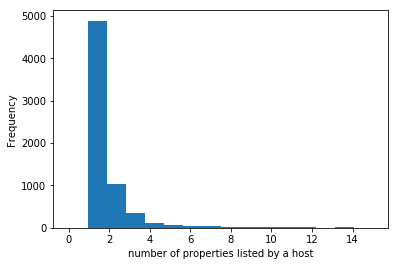

In [32]:
df['count'].plot(kind = 'hist', bins=16, range=(0,15))
plt.xlabel('number of properties listed by a host')

In [33]:
df_count = df.groupby('count').count().reset_index()
df_count.rename({'count': 'number of listed properties', 'host_id' : 'number of host'},axis='columns', inplace = True)
df_count.head()

,number of listed properties,number of host
0,1,4889
1,2,1038
2,3,342
3,4,125
4,5,73


**I narrow my objective down to consider the host that actually do business (i.e. lists more than 1 properties).**

In [34]:
list_re = list_used
for i in df[df['count']==1]['host_id'] :
    list_re.drop(list_re[list_re['host_id'] == i].index, axis = 0, inplace = True)

In [35]:
print(list_re.shape)
list_re.head(5)

(7330, 25)


,id,name,host_id,host_name,property_type,room_type,latitude,longitude,accommodates,bathrooms,...,guests_included,extra_people,minimum_nights_avg_ntm,availability_365,number_of_reviews,review_scores_value,review_scores_location,reviews_per_month,neighbourhood_group_cleansed,neighbourhood_cleansed
0,18666,Flat with Sunny Terrace,71615,Mireia And Maria,Apartment,Entire home/apt,41.40889,2.18555,6,1.0,...,2,25.0,3.0,91,1,8.0,10.0,0.02,Sant Martí,el Camp de l'Arpa del Clot
2,21605,Nice and sunny duble room,82522,Meritxell,Apartment,Private room,41.40560,2.19821,2,1.0,...,1,10.0,2.8,254,107,9.0,9.0,3.01,Sant Martí,el Poblenou
5,31377,"Room for 2, Sagrada Famili",134698,Svetlana,Apartment,Private room,41.41097,2.17070,2,1.0,...,2,5.0,3.0,178,4,9.0,9.0,0.08,Horta-Guinardó,el Baix Guinardó
6,31380,"Room for 2-3. Barcelona, Sagrada Famili",134698,Svetlana,Apartment,Private room,41.41090,2.17082,3,1.0,...,3,10.0,3.0,188,39,9.0,8.0,0.84,Horta-Guinardó,el Baix Guinardó
7,31958,"Gaudi Attic 1, Friendly Rentals",136853,Fidelio,Apartment,Entire home/apt,41.40950,2.15938,4,1.0,...,4,0.0,1.9,224,159,9.0,9.0,1.60,Gràcia,el Camp d'en Grassot i Gràcia Nova


Now, we have 7330 properties. 

In [36]:
# create map 
BC_map_re = folium.Map(location=BC_loc, zoom_start=13)

# add markers to map
for lat, lng in zip(list_re['latitude'], list_re['longitude']):
    folium.CircleMarker(
        [lat, lng],
        radius=1.5,
        color='blue',
        weight = 0.05,
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.3,
        parse_html=False).add_to(BC_map_re)  
    
BC_map_re

#### According to data provided by Inside Airbnb, Becalona has 10 districts and furture divided into 75 different neighborhoods
let's see how it's looked on the map.

In [37]:
BC_geo = 'neighbourhoods.geojson'

In [38]:
BC_details_df = pd.read_csv('./BC_details.csv')
BC_details_df.drop('Unnamed: 0', axis = 1, inplace = True)
BC_details_df.columns = ['neighbourhood_group', 'neighbourhood', 'neighbourhood_group_int'] 
BC_details_df.head()

,neighbourhood_group,neighbourhood,neighbourhood_group_int
0,Ciutat Vella,el Raval,1
1,Ciutat Vella,el Barri Gòtic,1
2,Ciutat Vella,la Barceloneta,1
3,Ciutat Vella,"Sant Pere, Santa Caterina i la Ribera",1
4,Eixample,la Dreta de l'Eixample,2


In [39]:
# create map 
BC_map3 = folium.Map(location=BC_loc, zoom_start=13)

folium.Choropleth(
    geo_data= BC_geo,
    data=BC_details_df,
    columns=['neighbourhood', 'neighbourhood_group_int'],
    key_on='feature.properties.neighbourhood',
    fill_color='Set3',
    fill_opacity=0.7,
    line_opacity=0.5,
    bins=10,
    reset=True
).add_to(BC_map3)

In [40]:
# Add circle markers to map for each properites
for lat, lng in zip(list_re['latitude'], list_re['longitude']):
    folium.CircleMarker(
        [lat, lng],
        radius=1.5,
        color='blue',
        weight = 0.05,
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.3,
        parse_html=False).add_to(BC_map3) 

In [41]:
## Add Markers for each attraction
for lat, lng, name in zip(atts_df['Attraction Latitude'], atts_df['Attraction Longitude'], atts_df['Attraction Name']):
    folium.Marker(
        [lat, lng],
        popup=name,
        parse_html=False).add_to(BC_map3) 

BC_map3

In [42]:
BC_details_df.drop_duplicates(subset='neighbourhood_group')[['neighbourhood_group','neighbourhood_group_int']]

,neighbourhood_group,neighbourhood_group_int
0,Ciutat Vella,1
4,Eixample,2
10,Gràcia,3
15,Horta-Guinardó,4
26,Les Corts,5
29,Nou Barris,6
42,Sant Andreu,7
49,Sant Martí,8
59,Sants-Montjuïc,9
67,Sarrià-Sant Gervasi,10


In [44]:
## Save above table to file, for furture use in presentation and report.
BC_details_df.drop_duplicates(subset='neighbourhood_group')[['neighbourhood_group','neighbourhood_group_int']].to_csv('labels_color.csv')

## Data Mining <a name = 'DM'></a>

First, the data was generalized data by calculating price per person with an assumption that number of guests in each property is maximum. Before that, the number of guests_included was checked if it is less than or equal number of accommodates. Because, it is not fair if the properties can serve less number of guests than the number of price included guests. If this happen, set 'guests_included' = 'accommodates'


In [45]:
list_re.loc[list_re['guests_included']> list_re['accommodates'], 'guests_included'] = np.NAN
list_re.guests_included.fillna(list_re.accommodates, inplace = True)

In [46]:
list_re[list_re['guests_included'] > list_re['accommodates']]

,id,name,host_id,host_name,property_type,room_type,latitude,longitude,accommodates,bathrooms,...,guests_included,extra_people,minimum_nights_avg_ntm,availability_365,number_of_reviews,review_scores_value,review_scores_location,reviews_per_month,neighbourhood_group_cleansed,neighbourhood_cleansed


In [47]:
list_re['Actual price'] = list_re['price'] + (list_re['accommodates'] - list_re['guests_included'])*list_re['extra_people']
list_re['price per person'] = list_re['Actual price']/list_re['accommodates']

In [48]:
## Have a quick check
list_re[['price per person', 'price', 'beds']].head(5)

,price per person,price,beds
0,38.333333,130.0,4.0
2,21.500000,33.0,1.0
5,21.000000,42.0,2.0
6,17.666667,53.0,2.0
7,15.500000,62.0,1.0


#### A quick summary

In [49]:
list_re.groupby('neighbourhood_group_cleansed').describe()['price per person']

,count,mean,std,min,25%,50%,75%,max
neighbourhood_group_cleansed,,,,,,,,
Ciutat Vella,1298.0,31.351764,20.696578,6.500000,20.762500,27.500,36.000000,333.333333
Eixample,2949.0,84.981121,463.389539,2.000000,22.000000,30.000,42.500000,6000.000000
Gràcia,585.0,37.762115,40.027835,1.500000,22.500000,28.000,37.333333,500.000000
Horta-Guinardó,183.0,32.678383,62.856794,10.000000,18.000000,22.500,28.000000,760.000000
Les Corts,166.0,45.884115,161.664751,7.000000,19.562500,27.500,31.916667,1500.000000
Nou Barris,66.0,20.372475,8.802185,8.000000,15.000000,17.500,23.000000,52.500000
Sant Andreu,81.0,25.204203,33.958135,8.333333,15.000000,20.000,25.000000,266.666667
Sant Martí,798.0,39.555705,96.958989,5.000000,20.000000,27.500,35.750000,2000.000000
Sants-Montjuïc,946.0,36.537948,62.163760,4.000000,20.000000,26.325,35.000000,750.000000


In [50]:
tot = list_re.groupby('neighbourhood_group_cleansed').describe()['price per person']['count'].sum()
percentage = ((list_re.groupby('neighbourhood_group_cleansed').describe()['price per person']['count']*100) / tot).round(2)
percentage

neighbourhood_group_cleansed
Ciutat Vella           17.71
Eixample               40.23
Gràcia                  7.98
Horta-Guinardó          2.50
Les Corts               2.26
Nou Barris              0.90
Sant Andreu             1.11
Sant Martí             10.89
Sants-Montjuïc         12.91
Sarrià-Sant Gervasi     3.52
Name: count, dtype: float64

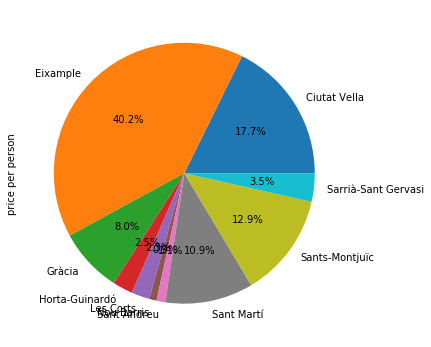

In [51]:
list_re.groupby('neighbourhood_group_cleansed').count()[['price per person']].plot(kind='pie', y = 'price per person',
                                                                    autopct='%1.1f%%', figsize = (8,6), legend = False )

plt.savefig('pie_count.png', dpi = 200)

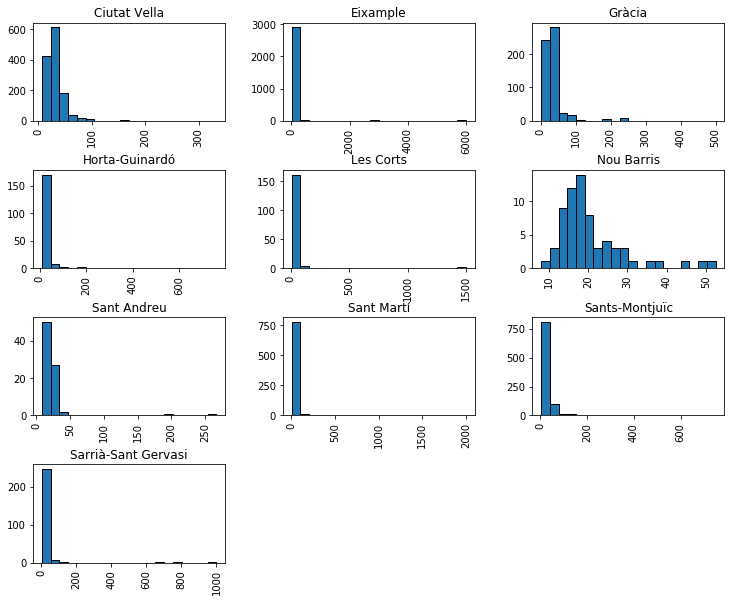

In [52]:
list_re.hist(by= 'neighbourhood_group_cleansed', column='price per person', bins = 20 , figsize=(12,10)
             , edgecolor= 'black')

plt.savefig('hist_neighbourhood_group.png', dpi = 200)

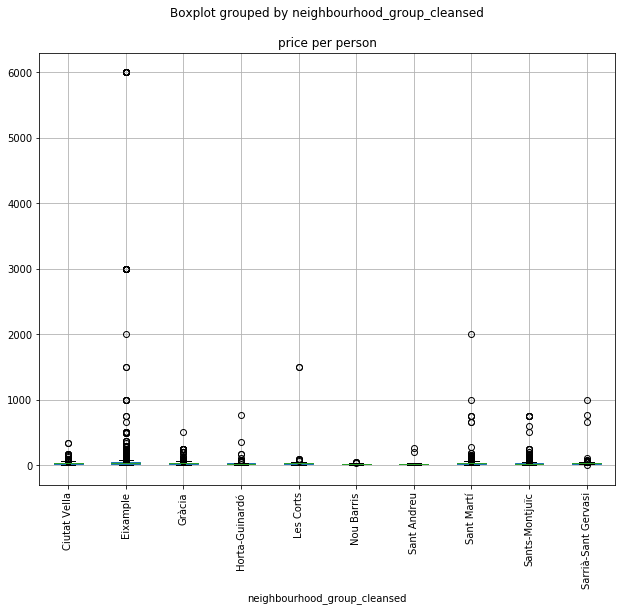

In [53]:
list_re.boxplot(by= 'neighbourhood_group_cleansed', column=['price per person'], figsize=(10,8), rot = 90)
plt.savefig('box_neighbourhood_group.png', dpi = 200)

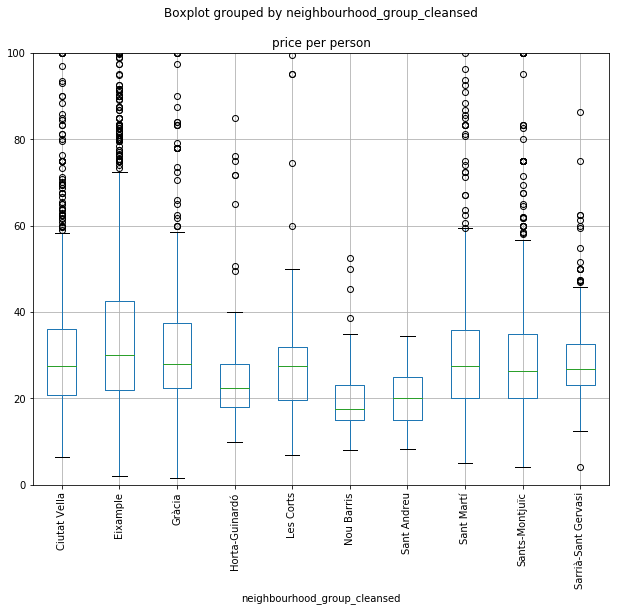

In [54]:
list_re.boxplot(by= 'neighbourhood_group_cleansed', column=['price per person'], figsize=(10,8), rot = 90)
plt.ylim(0,100)
plt.savefig('box_neighbourhood_group_Zoom.png', dpi = 200)

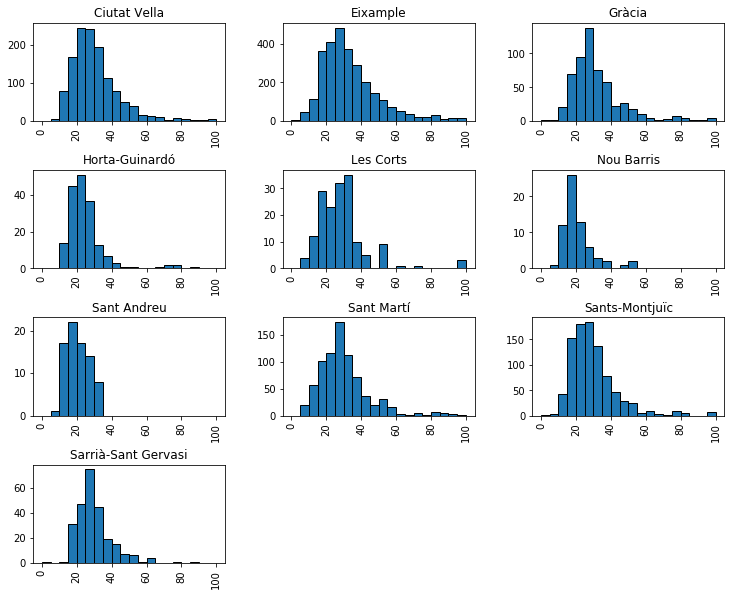

In [55]:
list_re.hist(by= 'neighbourhood_group_cleansed', column='price per person', bins = 20 , figsize=(12,10),
             range = [0,100], edgecolor= 'black')

plt.savefig('hist_neighbourhood_group_zoomin.png', dpi = 200)

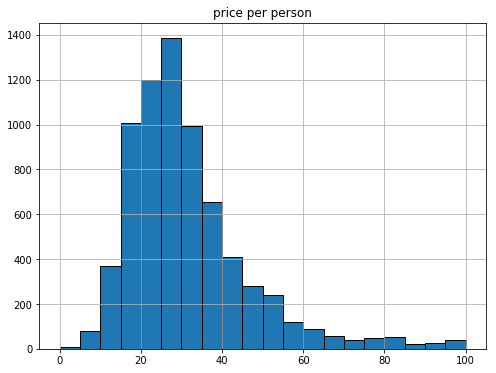

In [56]:
list_re.hist(column='price per person', bins = 20 , figsize=(8,6),
             range = [0,100], edgecolor= 'black')

plt.savefig('hist_zoomin.png', dpi = 200)

Group price/person into 5 groups :  
$  0 \leq x < 20  $   is 0  
$  20 \leq x < 40  $ is 1  
$  40 \leq x < 60  $ is 2   
$  60 \leq x < 80  $ is 3  
$  x \geq 80  $  is 4

In [57]:
list_re['PPH_class'] = list_re['price per person']//20
list_re.loc[list_re['PPH_class'] > 3, 'PPH_class'] = 4.0

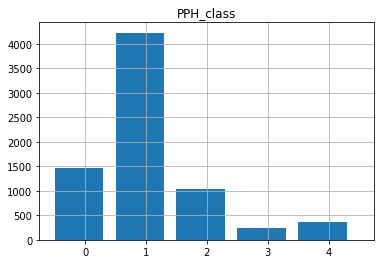

In [58]:
list_re[['PPH_class']].hist(bins=[-0.5,0.5,1.5,2.5,3.5,4.5], width = 0.8, range = (0,5))
plt.savefig('hist_PPH_class.png', dpi = 200)

In [59]:
# create map 
BC_map4 = folium.Map(location=BC_loc, zoom_start=13)

folium.Choropleth(
    geo_data= BC_geo,
    data=BC_details_df,
    columns=['neighbourhood', 'neighbourhood_group_int'],
    key_on='feature.properties.neighbourhood',
    fill_color='Set3',
    fill_opacity=0.4,
    line_opacity=0.3,
    bins=10,
    reset=True
).add_to(BC_map4)

## Add Markers for each attraction
for lat, lng, name in zip(atts_df['Attraction Latitude'], atts_df['Attraction Longitude'], atts_df['Attraction Name']):
    folium.Marker(
        [lat, lng],
        popup=name,
        parse_html=False).add_to(BC_map4) 

In [60]:
Colour_dict = { 0 : 'orange', 1 : 'red', 2 : 'green', 3 : 'purple', 4 : 'magenta'}

In [61]:
# Add circle markers to map for each properites
for lat, lng, cls in zip(list_re['latitude'], list_re['longitude'], list_re['PPH_class']):
    folium.CircleMarker(
        [lat, lng],
        radius=2.0,
        color= Colour_dict[cls] ,
        weight = 0.05,
        fill=True,
        fill_color=Colour_dict[cls],
        fill_opacity=0.6,
        parse_html=False).add_to(BC_map4) 
    
BC_map4

**As shown in the map**, there are differences of the distribution in each district. Therefore, I only focus in  Eixample district (highlighted in light-yellow). It covers about 40.23% of Bacelona busiiness properties listed in Airbnb.

In [62]:
list_UU = list_re[list_re['neighbourhood_group_cleansed'] == 'Eixample']

In [63]:
print (list_UU.shape)
list_UU.describe()

(2949, 28)


,id,host_id,latitude,longitude,accommodates,bathrooms,bedrooms,beds,price,cleaning_fee,...,extra_people,minimum_nights_avg_ntm,availability_365,number_of_reviews,review_scores_value,review_scores_location,reviews_per_month,Actual price,price per person,PPH_class
count,2.949000e+03,2.949000e+03,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,...,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000
mean,1.791701e+07,7.090970e+07,41.391014,2.164951,4.196338,1.475246,1.841641,2.862665,197.174975,35.567650,...,11.005765,1.990878,192.604273,39.639539,9.008035,9.666283,1.595310,222.394710,84.981121,1.299763
std,1.053620e+07,7.690976e+07,0.008701,0.009629,2.566174,0.721047,1.233995,2.409655,607.624523,38.247018,...,15.631320,0.759857,110.932120,60.566356,0.811288,0.547175,1.662177,608.762368,463.389539,1.037788
min,3.537900e+04,1.070400e+04,41.375100,2.143020,1.000000,0.500000,0.000000,0.000000,9.000000,0.000000,...,0.000000,1.000000,0.000000,0.000000,2.000000,2.000000,0.000000,9.000000,2.000000,0.000000
25%,8.077110e+06,4.064440e+06,41.384340,2.157530,2.000000,1.000000,1.000000,1.000000,50.000000,0.000000,...,0.000000,1.000000,103.000000,3.000000,9.000000,9.573977,0.280000,60.000000,22.000000,1.000000
50%,2.011348e+07,3.328214e+07,41.391010,2.164520,4.000000,1.000000,1.000000,2.000000,90.000000,25.000000,...,10.000000,2.000000,210.000000,15.000000,9.000000,10.000000,1.020000,119.000000,30.000000,1.000000
75%,2.657672e+07,1.425843e+08,41.397240,2.172960,6.000000,2.000000,2.000000,4.000000,165.000000,60.000000,...,20.000000,2.800000,289.000000,51.000000,9.079834,10.000000,2.440000,200.000000,42.500000,2.000000
max,3.376151e+07,2.524903e+08,41.410860,2.186280,16.000000,10.000000,12.000000,30.000000,6000.000000,360.000000,...,250.000000,3.000000,365.000000,502.000000,10.000000,10.000000,11.250000,6000.000000,6000.000000,4.000000


## Modelling <a name='Model'></a>

#### First, lets zoom-in and looks at Eixample.

In [64]:
# create map 
Ex_map = folium.Map(location=BC_loc, zoom_start=14)

folium.Choropleth(
    geo_data= BC_geo,
    data=BC_details_df,
    columns=['neighbourhood', 'neighbourhood_group_int'],
    key_on='feature.properties.neighbourhood',
    fill_color='Set3',
    fill_opacity=0.4,
    line_opacity=0.3,
    bins=10,
    reset=True
).add_to(Ex_map)

## Add Markers for each attraction
for lat, lng, name in zip(atts_df['Attraction Latitude'], atts_df['Attraction Longitude'], atts_df['Attraction Name']):
    folium.Marker(
        [lat, lng],
        popup=name,
        parse_html=False).add_to(Ex_map) 
    
# Add circle markers to map for each properites
for lat, lng, cls in zip(list_UU['latitude'], list_UU['longitude'], list_UU['PPH_class']):
    folium.CircleMarker(
        [lat, lng],
        radius=2.0,
        color= Colour_dict[cls] ,
        weight = 0.05,
        fill=True,
        fill_color=Colour_dict[cls],
        fill_opacity=0.6,
        parse_html=False).add_to(Ex_map) 
    
Ex_map

As shown in the map,Plaça de Catalunya is missing. **Add Plaza de Catalunya in the attraction list.** befoe do modelling.

In [65]:
query = 'Plaza de Catalunya'

url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&intent=global&query={}&near={}&limit={}'.format(
        CLIENT_ID, 
        CLIENT_SECRET, 
        VERSION, 
        query,
        city,
        LIMIT)
    
respond = requests.get(url).json()['response']['groups'][0]['items'][0]['venue']

In [66]:
atts_df = atts_df.append({'Attraction Name' : query, 
                'Attraction Latitude' : respond['location']['lat'] , 
                'Attraction Longitude' : respond['location']['lng']}, ignore_index=True)

In [67]:
print (atts_df.shape)
atts_df

(31, 3)


,Attraction Name,Attraction Latitude,Attraction Longitude
0,Basilica of the Sagrada Familia,41.403519,2.174354
1,Casa Batllo,41.391717,2.165009
2,Gothic Quarter (Barri Gotic),41.381915,2.177188
3,Palau de la Musica Catalana,41.387596,2.175298
4,Mercat de la Boqueria,41.381959,2.172011
5,Basilica de Santa Maria del Mar,41.403045,2.174074
6,Casa Mila - La Pedrera,41.396508,2.159690
7,The Magic Fountain,41.371225,2.151823
8,Camp Nou,41.380794,2.122743
9,Recinte Modernista de Sant Pau,41.411352,2.174380


#### Try to get more attractions from foursqure.

In [68]:
query = 'attraction'
city = 'Eixample'
LIMIT = 50
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&intent=global&query={}&near={}&limit={}'.format(
        CLIENT_ID, 
        CLIENT_SECRET, 
        VERSION, 
        query,
        city,
        LIMIT)
respond = requests.get(url).json()

In [69]:
respond

{'meta': {'code': 200, 'requestId': '5cff711c6a6071493f93446c'},
 'response': {'geocode': {'what': '',
   'where': 'eixample',
   'center': {'lat': 41.38896, 'lng': 2.16179},
   'displayString': 'Eixample, Catalonia, Spain',
   'cc': 'ES',
   'slug': 'eixample-spain',
   'longId': '72057594044472036'},
  'headerLocation': 'Current map view',
  'headerFullLocation': 'Current map view',
  'headerLocationGranularity': 'unknown',
  'query': 'attraction',
  'totalResults': 7,
  'suggestedBounds': {'ne': {'lat': 41.39484976357567,
    'lng': 2.1688185655905694},
   'sw': {'lat': 41.38512153593245, 'lng': 2.156787996618219}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '4b39cb3df964a520015f25e3',
       'name': 'Hotel Pulitzer',
       'location': {'address': 'C. Bergara, 8'

In [70]:
for i in range(len(respond['response']['groups'][0]['items'])) :
    print (respond['response']['groups'][0]['items'][i]['venue']['name'])

Hotel Pulitzer
Hotel Praktik Rambla
Hotel Jazz
Hotel América
Hotel Claris
Sansi Disputacio
Hotel Grupotel Gravina


For unknown reason, Foursqure api only give the popular hotel name from the searching with query of 'attraction'. So I ignore this result.  
### Let calculate the minumum distance to the nearest attraction.

In [71]:
from geopy.distance import geodesic
list_UU[['id', 'latitude', 'longitude']].head()

,id,latitude,longitude
13,35379,41.39029,2.15268
14,35388,41.39058,2.15190
15,35390,41.39147,2.15118
16,35392,41.39075,2.15072
18,40983,41.39560,2.16761


In [72]:
atts_df.head()

,Attraction Name,Attraction Latitude,Attraction Longitude
0,Basilica of the Sagrada Familia,41.403519,2.174354
1,Casa Batllo,41.391717,2.165009
2,Gothic Quarter (Barri Gotic),41.381915,2.177188
3,Palau de la Musica Catalana,41.387596,2.175298
4,Mercat de la Boqueria,41.381959,2.172011


In [73]:
min_dist = []
for P_id, P_loc in zip(list_UU.id, zip(list_UU.latitude, list_UU.longitude)) :
    distances = []
    for A_name, A_loc in zip(atts_df['Attraction Name'], zip(atts_df['Attraction Latitude'], atts_df['Attraction Longitude'])) :
        distances.append([P_id, A_name, geodesic(P_loc, A_loc).km])
    distances = np.array(distances)
    min_dist.append(distances[np.argmin(distances[:,2])])

In [74]:
min_dist_df = pd.DataFrame(min_dist)
min_dist_df.columns = ['id', 'Attraction name', 'min dist_km']
min_dist_df['min dist'] = (pd.to_numeric(min_dist_df['min dist_km']) *1000).round(2) ## Convert to meters
print (min_dist_df.shape)
min_dist_df.head()

(2949, 4)


,id,Attraction name,min dist_km,min dist
0,35379,L'Eixample District,0.6800328387817579,680.03
1,35388,L'Eixample District,0.7327190467870182,732.72
2,35390,L'Eixample District,0.7727190248218003,772.72
3,35392,L'Eixample District,0.8241010029847395,824.10
4,40983,Passeig de Gracia,0.4822343148601498,482.23


In [75]:
min_dist_df.drop('min dist_km', axis =1, inplace = True)

In [76]:
min_dist_df.head()

,id,Attraction name,min dist
0,35379,L'Eixample District,680.03
1,35388,L'Eixample District,732.72
2,35390,L'Eixample District,772.72
3,35392,L'Eixample District,824.10
4,40983,Passeig de Gracia,482.23


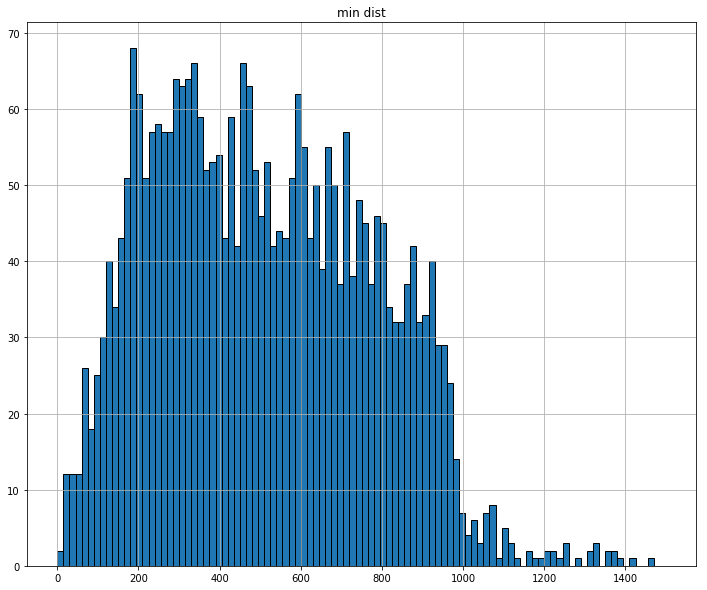

In [78]:
min_dist_df.hist(column ='min dist', figsize=(12,10), edgecolor= 'black',  range=(0,1500), bins=100)
plt.savefig('hist_mindist.png', dpi = 200)

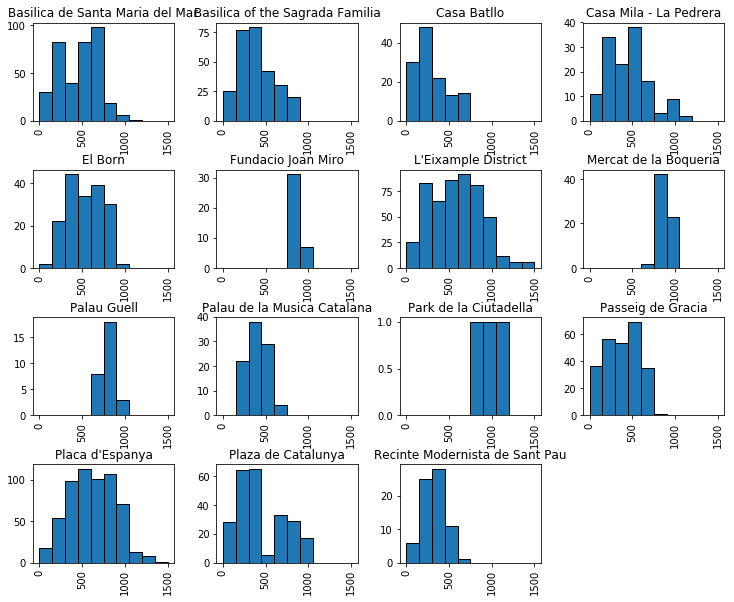

In [79]:
min_dist_df.hist(column ='min dist', by='Attraction name', figsize=(12,10), edgecolor= 'black', range=(0,1500))
plt.savefig('hist_mindist_attr.png', dpi = 200)

In [112]:
min_dist_df[min_dist_df['min dist'] < 500].groupby('Attraction name').count()['id']

Attraction name
Basilica de Santa Maria del Mar    181
Basilica of the Sagrada Familia    208
Casa Batllo                        106
Casa Mila - La Pedrera              80
El Born                             84
L'Eixample District                201
Palau de la Musica Catalana         71
Passeig de Gracia                  178
Placa d'Espanya                    201
Plaza de Catalunya                 159
Recinte Modernista de Sant Pau      65
Name: id, dtype: int64

In [80]:
min_dist_df['id'] = min_dist_df['id'].astype(str).astype(int)
df = pd.merge(list_UU, min_dist_df, on= 'id')

In [81]:
df.head()

,id,name,host_id,host_name,property_type,room_type,latitude,longitude,accommodates,bathrooms,...,review_scores_value,review_scores_location,reviews_per_month,neighbourhood_group_cleansed,neighbourhood_cleansed,Actual price,price per person,PPH_class,Attraction name,min dist
0,35379,Double 02 CasanovaRooms Barcelona,152232,Pablo,Bed and breakfast,Private room,41.39029,2.15268,2,2.0,...,9.0,9.0,2.70,Eixample,l'Antiga Esquerra de l'Eixample,45.0,22.50,1.0,L'Eixample District,680.03
1,35388,Single 01 CasanovaRooms Barcelona,152232,Pablo,Bed and breakfast,Private room,41.39058,2.15190,1,2.0,...,9.0,9.0,2.03,Eixample,l'Antiga Esquerra de l'Eixample,30.0,30.00,1.0,L'Eixample District,732.72
2,35390,Single 02 CasanovaRooms Barcelona,152232,Pablo,Bed and breakfast,Private room,41.39147,2.15118,1,2.0,...,10.0,10.0,2.31,Eixample,l'Antiga Esquerra de l'Eixample,30.0,30.00,1.0,L'Eixample District,772.72
3,35392,Double 01 CasanovaRooms Barcelona,152232,Pablo,Bed and breakfast,Private room,41.39075,2.15072,2,2.0,...,9.0,10.0,2.95,Eixample,l'Antiga Esquerra de l'Eixample,50.0,25.00,1.0,L'Eixample District,824.10
4,40983,Classical loft close to pedrera!,177617,Joaquin,Loft,Entire home/apt,41.39560,2.16761,4,1.0,...,9.0,10.0,1.26,Eixample,la Dreta de l'Eixample,115.0,28.75,1.0,Passeig de Gracia,482.23


In [82]:
df.drop(['host_id', 'host_name', 'accommodates', 'bathrooms', 'bedrooms', 'beds', \
        'cleaning_fee', 'security_deposit','price', 'cleaning_fee', 'security_deposit', 'guests_included', 'extra_people', \
         'minimum_nights_avg_ntm', 'availability_365','neighbourhood_group_cleansed'], axis = 1, inplace = True)

In [83]:
print (df.shape)
df.head()

(2949, 16)


,id,name,property_type,room_type,latitude,longitude,number_of_reviews,review_scores_value,review_scores_location,reviews_per_month,neighbourhood_cleansed,Actual price,price per person,PPH_class,Attraction name,min dist
0,35379,Double 02 CasanovaRooms Barcelona,Bed and breakfast,Private room,41.39029,2.15268,233,9.0,9.0,2.70,l'Antiga Esquerra de l'Eixample,45.0,22.50,1.0,L'Eixample District,680.03
1,35388,Single 01 CasanovaRooms Barcelona,Bed and breakfast,Private room,41.39058,2.15190,194,9.0,9.0,2.03,l'Antiga Esquerra de l'Eixample,30.0,30.00,1.0,L'Eixample District,732.72
2,35390,Single 02 CasanovaRooms Barcelona,Bed and breakfast,Private room,41.39147,2.15118,194,10.0,10.0,2.31,l'Antiga Esquerra de l'Eixample,30.0,30.00,1.0,L'Eixample District,772.72
3,35392,Double 01 CasanovaRooms Barcelona,Bed and breakfast,Private room,41.39075,2.15072,164,9.0,10.0,2.95,l'Antiga Esquerra de l'Eixample,50.0,25.00,1.0,L'Eixample District,824.10
4,40983,Classical loft close to pedrera!,Loft,Entire home/apt,41.39560,2.16761,120,9.0,10.0,1.26,la Dreta de l'Eixample,115.0,28.75,1.0,Passeig de Gracia,482.23


In [84]:
from sklearn.cluster import KMeans

Check relation between minimum distance and location review score

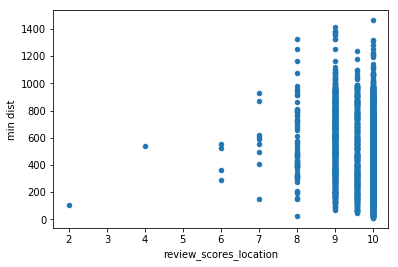

In [85]:
df.plot(kind='scatter', x='review_scores_location' , y='min dist')
plt.savefig('scatter_review_mindist.png', dpi = 200)

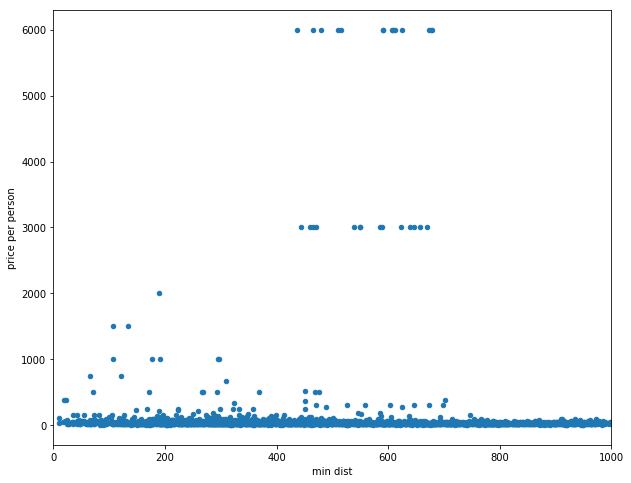

In [86]:
# Check relation between minimum distance and price
df.plot(kind='scatter', y='price per person' , x='min dist', figsize=(10,8))
plt.xlim(0,1000)
plt.savefig('scatter_distance_price.png', dpi = 200)

#### Lable price per person as very close (0-400 meters), near (400-800), and far (>800)

In [87]:
dict_dist = {0 : 'very close', 1: 'near', 2:'far'}
df['dist_cls'] = df['min dist'].apply(lambda x : dict_dist[x//400] if (x < 800) else 'far')

In [88]:
set(df['dist_cls'])

{'far', 'near', 'very close'}

In [89]:
dict_price = {0 : 'price:very low', 1: 'price:low', 2:'price:average', 3:'price:high', 4 : 'price:very high'}
df['price_cls'] = df['price per person'].apply(lambda x : dict_price[x//400] if (x < 1600) else 'price:very high')

In [90]:
set(df['price_cls'])

{'price:average',
 'price:high',
 'price:low',
 'price:very high',
 'price:very low'}

In [91]:
dict_rev = {0 : 'review:very bad', 1: 'review:bad', 2:'review:average', 3:'review:good', 4 : 'review:excellent'}
df['rev_cls'] = df['review_scores_value'].apply(lambda x : dict_rev[(x-1)//2])

In [92]:
set(df['rev_cls'])

{'review:average',
 'review:bad',
 'review:excellent',
 'review:good',
 'review:very bad'}

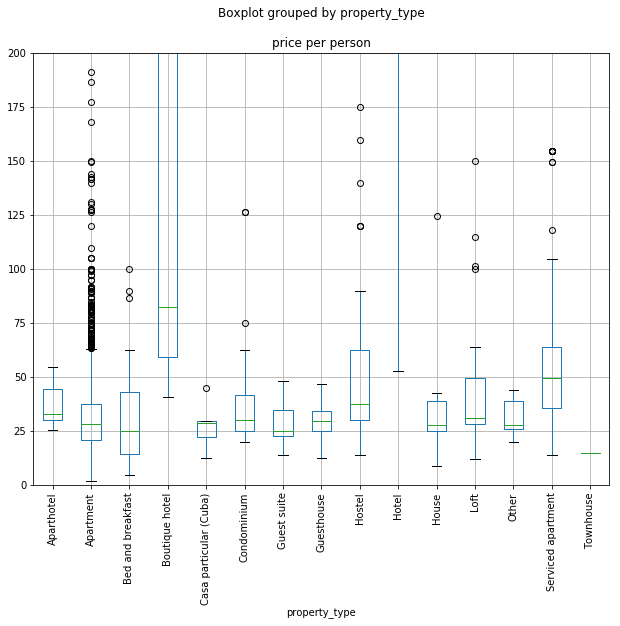

In [93]:
df.boxplot(by= 'property_type', column=['price per person'], figsize=(10,8), rot = 90)
plt.ylim(0,200)
plt.savefig('box_property_type_Zoom.png', dpi = 200)

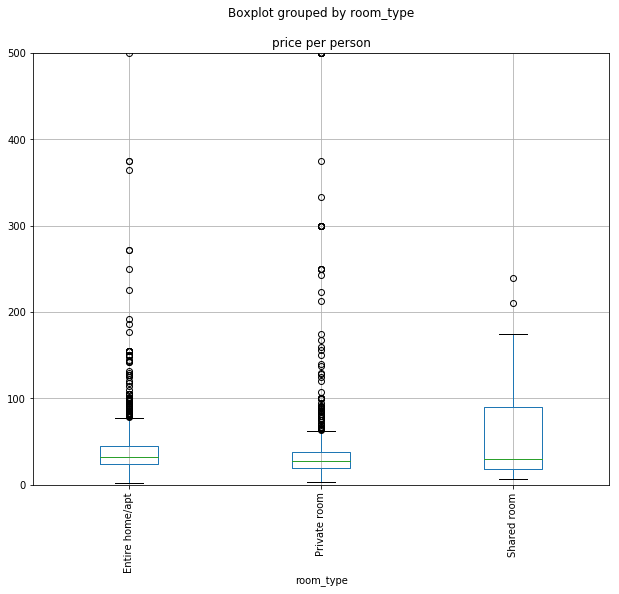

In [94]:
df.boxplot(by= 'room_type', column=['price per person'], figsize=(10,8), rot = 90)
plt.ylim(0,500)
plt.savefig('box_room_type_Zoom.png', dpi = 200)

### Prepare data for K-mean clustering

In [95]:
df_onehot = pd.concat([pd.get_dummies(df[['property_type']], prefix="", prefix_sep=""), \
          pd.get_dummies(df[['room_type']], prefix="", prefix_sep=""), \
          pd.get_dummies(df[['price_cls']], prefix="", prefix_sep=""), \
          pd.get_dummies(df[['rev_cls']], prefix="", prefix_sep=""), \
           pd.get_dummies(df[['dist_cls']], prefix="", prefix_sep="")], 
          axis=1, join='inner')

In [96]:
print (df_onehot.shape)
df_onehot.head()

(2949, 31)


,Aparthotel,Apartment,Bed and breakfast,Boutique hotel,Casa particular (Cuba),Condominium,Guest suite,Guesthouse,Hostel,Hotel,...,price:very high,price:very low,review:average,review:bad,review:excellent,review:good,review:very bad,far,near,very close
0,0,0,1,0,0,0,0,0,0,0,...,0,1,0,0,1,0,0,0,1,0
1,0,0,1,0,0,0,0,0,0,0,...,0,1,0,0,1,0,0,0,1,0
2,0,0,1,0,0,0,0,0,0,0,...,0,1,0,0,1,0,0,0,1,0
3,0,0,1,0,0,0,0,0,0,0,...,0,1,0,0,1,0,0,1,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,1,0,0,0,1,0


### Run k-means clustering

In [97]:
kclusters = 10
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(df_onehot)
print (len(kmeans.labels_))

2949


In [98]:
df['Klabels'] = kmeans.labels_

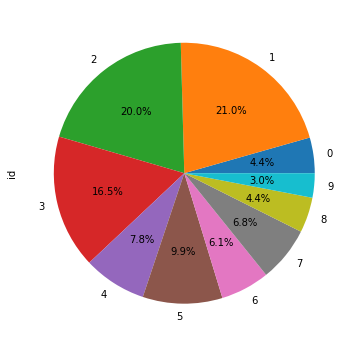

In [99]:
df.groupby('Klabels').count()[['id']].plot(kind='pie', y = 'id',autopct='%1.1f%%', 
                                 figsize = (8,6), legend = False )
plt.savefig('pie_Klabels.png', dpi = 200)

In [100]:
# create map 
Ex_map = folium.Map(location=BC_loc, zoom_start=14)
Colour_dict = { 0 : 'blue', 1 : 'orange', 2 : 'green', 3 : 'red', 4 : 'purple', 5 : 'brown', 6 : 'pink', 
               7:'grey', 8: 'gold', 9:'skyblue'}

## Add Markers for each attraction
for lat, lng, name in zip(atts_df['Attraction Latitude'], atts_df['Attraction Longitude'], atts_df['Attraction Name']):
    folium.Marker(
        [lat, lng],
        popup=name,
        parse_html=False).add_to(Ex_map) 
    
# Add circle markers to map for each properites
for lat, lng, cls in zip(df['latitude'], df['longitude'], df['Klabels']):
    folium.CircleMarker(
        [lat, lng],
        radius=2.0,
        color= Colour_dict[cls] ,
        weight = 0.05,
        fill=True,
        fill_color=Colour_dict[cls],
        fill_opacity=0.8,
        parse_html=False).add_to(Ex_map) 
    
Ex_map

### Profiling

In [101]:
df[df['Klabels']==0].groupby(['property_type','room_type','dist_cls','price_cls','rev_cls']).count()['id']

property_type           room_type     dist_cls    price_cls       rev_cls         
Aparthotel              Private room  very close  price:very low  review:good          1
Bed and breakfast       Private room  very close  price:high      review:excellent     1
                                                  price:very low  review:excellent    19
                                                                  review:good          5
                        Shared room   very close  price:very low  review:excellent     1
Boutique hotel          Private room  very close  price:average   review:excellent     2
                                                                  review:good          1
                                                  price:low       review:excellent     5
                                                  price:very low  review:excellent    21
Casa particular (Cuba)  Private room  very close  price:very low  review:excellent     2
Condominium             Pri

**Group 1 (4.4%)** : Excellent reveiw, privete room, price very low, very close

In [102]:
df[df['Klabels']==1].groupby(['property_type','room_type','dist_cls','price_cls','rev_cls']).count()['id']

property_type       room_type        dist_cls    price_cls        rev_cls         
Aparthotel          Entire home/apt  very close  price:very low   review:excellent      6
Apartment           Entire home/apt  very close  price:high       review:excellent      1
                                                 price:low        review:excellent      3
                                                 price:very low   review:average        8
                                                                  review:bad            1
                                                                  review:excellent    486
Condominium         Entire home/apt  very close  price:very low   review:excellent     15
Guest suite         Entire home/apt  very close  price:very low   review:excellent      1
House               Entire home/apt  very close  price:very low   review:excellent      1
Loft                Entire home/apt  very close  price:very low   review:excellent      7
Serviced apartmen

**Group 2 (21%)** : Excellent review, Entire home/apt, very close, Apartment/Service apartment with very low price

In [103]:
df[df['Klabels']==2].groupby(['property_type','room_type','dist_cls','price_cls','rev_cls']).count()['id']

property_type           room_type     dist_cls  price_cls        rev_cls         
Apartment               Private room  near      price:very low   review:average        1
                                                                 review:bad            2
                                                                 review:excellent    412
                                                                 review:good          43
                        Shared room   near      price:very low   review:excellent      1
Bed and breakfast       Private room  near      price:very high  review:excellent      2
                                                price:very low   review:average        1
                                                                 review:excellent     18
                                                                 review:good           1
                        Shared room   near      price:very low   review:excellent      1
Boutique hotel          Priv

**Group 3 (20.0%)** : private room, near, very low price, excellent/good review 

In [104]:
df[df['Klabels']==3].groupby(['property_type','room_type','dist_cls','price_cls','rev_cls']).count()['id']

property_type  room_type        dist_cls  price_cls       rev_cls         
Apartment      Entire home/apt  near      price:low       review:excellent      1
                                          price:very low  review:average       10
                                                          review:bad            1
                                                          review:excellent    449
                                                          review:very bad       1
Condominium    Entire home/apt  near      price:very low  review:excellent     12
Guest suite    Entire home/apt  near      price:very low  review:excellent      1
Loft           Entire home/apt  near      price:very low  review:excellent     13
Name: id, dtype: int64

**Group 4 (16.5%)** : Entire home/apt,near, very low price, excellent review

In [105]:
df[df['Klabels']==4].groupby(['property_type','room_type','dist_cls','price_cls','rev_cls']).count()['id']

property_type       room_type     dist_cls  price_cls       rev_cls         
Apartment           Private room  far       price:very low  review:average        5
                                                            review:excellent    166
                                                            review:good          27
                                                            review:very bad       1
Bed and breakfast   Private room  far       price:very low  review:excellent      8
                                                            review:good           1
Boutique hotel      Private room  far       price:very low  review:excellent     13
Condominium         Private room  far       price:very low  review:excellent      2
Hostel              Private room  far       price:very low  review:excellent      1
Hotel               Private room  far       price:very low  review:excellent      1
House               Private room  far       price:very low  review:excellent      1

**Group 5 (7.8%)** : Private room, far, very low price, and excellent review

In [106]:
df[df['Klabels']==5].groupby(['property_type','room_type','dist_cls','price_cls','rev_cls']).count()['id']

property_type  room_type     dist_cls    price_cls       rev_cls         
Apartment      Private room  very close  price:very low  review:average        3
                                                         review:excellent    253
                                                         review:good          33
                                                         review:very bad       1
               Shared room   very close  price:very low  review:excellent      1
Name: id, dtype: int64

**Group 6 (9.9%)** : Apartment, priveate room, very close, excellent review

In [107]:
df[df['Klabels']==6].groupby(['property_type','room_type','dist_cls','price_cls','rev_cls']).count()['id']

property_type       room_type        dist_cls    price_cls       rev_cls    
Apartment           Entire home/apt  far         price:very low  review:good     42
                                     very close  price:very low  review:good    125
Loft                Entire home/apt  far         price:very low  review:good      2
                                     very close  price:very low  review:good      2
Serviced apartment  Entire home/apt  far         price:very low  review:good      1
                                     very close  price:very low  review:good      7
Name: id, dtype: int64

**Group 7 (6.1%)** : Entire home/apt, either very close or far, good review.

In [108]:
df[df['Klabels']==7].groupby(['property_type','room_type','dist_cls','price_cls','rev_cls']).count()['id']

property_type       room_type        dist_cls  price_cls       rev_cls         
Apartment           Entire home/apt  far       price:very low  review:average        3
                                                               review:excellent    173
                    Shared room      far       price:very low  review:excellent      1
Condominium         Entire home/apt  far       price:very low  review:excellent      4
Loft                Entire home/apt  far       price:very low  review:excellent      4
Serviced apartment  Entire home/apt  far       price:very low  review:excellent     16
Name: id, dtype: int64

**Group 8 (6.8%)** : Entire home/apt, far, very low price and exellent review.

In [109]:
df[df['Klabels']==8].groupby(['property_type','room_type','dist_cls','price_cls','rev_cls']).count()['id']

property_type       room_type        dist_cls  price_cls       rev_cls    
Apartment           Entire home/apt  near      price:very low  review:good    120
                    Shared room      near      price:very low  review:good      1
Condominium         Entire home/apt  near      price:very low  review:good      4
Serviced apartment  Entire home/apt  near      price:very low  review:good      4
Name: id, dtype: int64

**Group 9 (4.4%)** : Property types are Apartment, Condominium, and Serviced apartment. Entire home/apt, very low price, good review, and near attraction.

In [110]:
df[df['Klabels']==9].groupby(['property_type','room_type','dist_cls','price_cls','rev_cls']).count()['id']

property_type       room_type        dist_cls  price_cls       rev_cls         
Serviced apartment  Entire home/apt  near      price:very low  review:excellent    89
Name: id, dtype: int64

**Group 10 (3.0%)** : Serviced apartment with Entire home/apt room type.  Price is very low, Excellent review, and near attraction.